## Cleaning

In [ ]:
!rm -rf data/

In [ ]:
drive.flush_and_unmount()

## Imports

In [ ]:
import os
import datetime
import numpy as np
import pandas as pd

import torch
from torch.utils import data
from torch.utils.data import Dataset
from torchvision import transforms
from torch import nn
from torch.nn import functional as F
from torch.utils.tensorboard import SummaryWriter
import torch.optim as optim

from scipy import interpolate
from matplotlib import pyplot as plt
from matplotlib.collections import LineCollection
from matplotlib.colors import ListedColormap, BoundaryNorm

In [ ]:
%load_ext tensorboard

##Statistics

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')

In [ ]:
dataframe = pd.read_csv('gdrive/MyDrive/ECG/labels.csv', header=None, names=['id', 'label', 'gender', 'age', 'height', 'weight']).astype(int)
dataframe

In [ ]:
dataframe['label'].value_counts()

In [ ]:
dataframe.describe()

## Common components

### Dataset

In [ ]:
class EcgDataset(Dataset):
    def __init__(self, root_dir, labels_file, data_folder, transform=None):
        labels_file_path = os.path.join(root_dir, labels_file)
        self.common_frame = pd.read_csv(labels_file_path, header=None)

        self.data_dir = os.path.join(root_dir, data_folder)
        self.transform = transform

    def __len__(self):
        return self.common_frame.shape[0]

    def __getitem__(self, idx):
        if torch.is_tensor(idx):
            idx = idx.tolist()

        needed_row = self.common_frame.iloc[idx]

        data_file = str(needed_row[0].astype(int)) + '.csv'
        label = needed_row[1]
        gender = needed_row[2]
        age = needed_row[3]
        height = needed_row[4]
        weight = needed_row[5]

        data_file_path = os.path.join(self.data_dir, data_file)
        data_frame = pd.read_csv(data_file_path, header=None)

        sample = (gender, age, height, weight), data_frame.to_numpy(dtype='float32').transpose(), label

        if self.transform:
            sample = self.transform(sample)

        return sample


### Transform

In [ ]:
class CutOff(object):
    def __init__(self, max_width=5000):
        self.max_width = max_width

    def __call__(self, sample):
        (gender, age, height, weight), data, label = sample
        return (gender, age, height, weight), np.delete(data, np.s_[self.max_width:], 1), label


class ToTensor(object):
    def __call__(self, sample):
        (gender, age, height, weight), data, label = sample
        return torch.tensor([gender, age, height, weight]), torch.from_numpy(data), label - 1


### Data manager

In [ ]:
class DataManager:
    def __init__(self, train_dir='data/train', test_dir='data/test', labels_file='labels.csv', data_folder='samples', batch_size=256):
        self._train_dir = train_dir
        self._test_dir = test_dir
        self._labels_file = labels_file
        self._data_folder = data_folder
        self._batch_size = batch_size

        self._cnn_transforms = transforms.Compose([ToTensor()])

        self.cuda_params = {'num_workers': 8, 'pin_memory': True} if torch.cuda.is_available() else {}

    def get_train_loader(self, need_shuffle=True, custom_batch_size=None):
        if self._train_dir is None:
            return None

        dataset = EcgDataset(
            root_dir=self._train_dir,
            labels_file=self._labels_file,
            data_folder=self._data_folder,
            transform=self._cnn_transforms,
        )

        batch_size = self._batch_size if custom_batch_size is None else custom_batch_size
        return torch.utils.data.DataLoader(
            dataset, batch_size=batch_size, shuffle=need_shuffle, **self.cuda_params
        )

    def get_test_loader(self, need_shuffle=True, custom_batch_size=None):
        if self._test_dir is None:
            return None

        dataset = EcgDataset(
            root_dir=self._test_dir,
            labels_file=self._labels_file,
            data_folder=self._data_folder,
            transform=self._cnn_transforms,
        )

        batch_size = self._batch_size if custom_batch_size is None else custom_batch_size
        return torch.utils.data.DataLoader(
            dataset, batch_size=batch_size, shuffle=need_shuffle, **self.cuda_params
        )


## Models (run only needed block)

### CAM

Highest accuracy on test dataset ~ 47% (0.4765625)

#### Network

In [ ]:
class ExplainableNN(nn.Module):
    def __init__(self):
        super(ExplainableNN, self).__init__()

        # convolutional layers
        self.conv1 = nn.Conv1d(12, 24, kernel_size=3)
        self.conv2 = nn.Conv1d(24, 48, kernel_size=3)
        self.conv3 = nn.Conv1d(48, 96, kernel_size=3)

        # max pooling
        self.maxPooling = nn.MaxPool1d(kernel_size=3)

        self.batchNorm = nn.BatchNorm1d(num_features=12)

        self.flat_size = 96 * 91
        self.feed_forward_input_size = 96 * 91 + 2

        # dropouts
        self.dropout25 = nn.Dropout(0.25)

        self.gap = nn.AvgPool1d(kernel_size=184)  # в качестве kernel_size берется размерность канала
        self.linear = nn.Linear(96, 9)
        self.sigmoid = nn.Sigmoid()

    def forward(self, x1, x2):
        x2 = self.batchNorm(x2)
        x2 = self.maxPooling(F.relu(self.conv1(x2)))
        x2 = self.maxPooling(F.relu(self.conv2(x2)))
        x2 = self.maxPooling(F.relu(self.conv3(x2)))
        x2 = self.dropout25(x2)

        x2 = self.gap(x2)
        x2 = x2.view(x2.shape[0], -1)
        # data = torch.cat([x1.float(), x2], 1)
        data = x2
        data = self.linear(data)
        # conv_data = self.sigmoid(conv_data)
        data = F.softmax(data, dim=1)

        return data

#### Extract

In [ ]:
class SaveFeatures:
    features = None

    def __init__(self, m):
        self.hook = m.register_forward_hook(self.hook_fn)

    def hook_fn(self, module, input, output):
        self.features = (output.cpu()).data.numpy()

    def remove(self):
        self.hook.remove()


def extract_cam(model, sample):
    feature_layer_name = 'dropout25'
    fc_layer_name = 'linear'
    feature_layer = model._modules.get(feature_layer_name)
    activated_features = SaveFeatures(feature_layer)

    (x1, x2, y) = sample
    if torch.cuda.is_available():
        x1, x2, y = x1.cuda(), x2.cuda(), y.cuda()
        model.cuda()

    model.eval()
    out = model(x1, x2)
    pred_probabilities = out.data.squeeze()
    probs, idx = pred_probabilities.sort(0, True)
    activated_features.remove()

    weight_softmax_params = list(model._modules.get(fc_layer_name).parameters())
    weight_softmax = np.squeeze(weight_softmax_params[0].cpu().data.numpy())

    for i in range(0, 3):
        line = '{:.3f} -> {}'.format(probs[i], idx[i].item())
        print(line)

    class_id = idx[0].item()
    feature_conv = activated_features.features
    batch_size, channels_count, channel_size = feature_conv.shape
    cam = weight_softmax[class_id].dot(feature_conv.reshape((channels_count, -1)))
    cam = cam - np.min(cam)
    return cam

### GradCAM

#### Network

In [ ]:
class ExplainableNN(nn.Module):
    def __init__(self):
        super(ExplainableNN, self).__init__()

        self.conv1 = nn.Conv1d(12, 24, kernel_size=3)
        self.conv2 = nn.Conv1d(24, 48, kernel_size=3)
        self.conv3 = nn.Conv1d(48, 96, kernel_size=3)

        self.fc1 = nn.Linear(17668, 1024)
        self.fc2 = nn.Linear(1024, 512)
        self.fc3 = nn.Linear(512, 9)

        self.maxPooling = nn.MaxPool1d(kernel_size=3)

        self.batchNorm = nn.BatchNorm1d(num_features=12)

        self.dropout25 = nn.Dropout(0.25)

        # placeholder for the gradients
        self.gradients = None

    def activations_hook(self, grad):
        self.gradients = grad

    def _apply_conv(self, x):
        x = self.batchNorm(x)
        x = self.maxPooling(F.relu(self.conv1(x)))
        x = self.maxPooling(F.relu(self.conv2(x)))
        x = self.maxPooling(F.relu(self.conv3(x)))
        x = self.dropout25(x)
        return x

    def forward(self, x1, x2):
        x2 = self._apply_conv(x2)

        # register the hook
        if not self.training and x2.requires_grad:
            x2.register_hook(self.activations_hook)

        x2 = x2.view(x2.shape[0], -1)
        x = torch.cat([x1.float(), x2], 1)

        x = F.relu(self.fc1(x))
        x = F.relu(self.fc2(x))
        x = F.log_softmax(self.fc3(x), dim=1)
        return x

    # method for the gradient extraction
    def get_activations_gradient(self):
        return self.gradients

    # method for the activation extraction
    def get_activations(self, x1, x2):
        return self._apply_conv(x2)


#### Extract

In [ ]:
def extract_cam(model, sample):
    (x1, x2, y) = sample
    if torch.cuda.is_available():
        x1, x2, y = x1.cuda(), x2.cuda(), y.cuda()
        model.cuda()

    model.eval()
    out = model(x1, x2)

    predicted_class = out.cpu().detach().squeeze().numpy().argmax()
    # we are going to do the back-propagation with the logit of specific class
    out[:, predicted_class].backward()

    # pull the gradients out of the model
    gradients = model.get_activations_gradient()

    # pool the gradients across the channels
    pooled_gradients = torch.mean(gradients, dim=[0, 2])

    # get the activations of the last convolutional layer
    activations = model.get_activations(x1, x2).detach()

    # weight the channels by corresponding gradients
    for i in range(96):
        activations[:, i, :] *= pooled_gradients[i]

    print(f"Predicted class: {np.argmax(out.detach().cpu().numpy()[0])}")

    # average the channels of the activations
    grad_cam = torch.mean(activations, dim=1).squeeze().cpu().numpy()
    grad_cam = grad_cam - np.min(grad_cam)
    return grad_cam

Highest accuracy on test dataset ~ 62% (0.6211)

### GradCAM + more dropouts

#### Network

In [ ]:
class ExplainableNN(nn.Module):
    def __init__(self):
        super(ExplainableNN, self).__init__()

        self.conv1 = nn.Conv1d(12, 24, kernel_size=3)
        self.conv2 = nn.Conv1d(24, 48, kernel_size=3)
        self.conv3 = nn.Conv1d(48, 96, kernel_size=3)

        self.fc1 = nn.Linear(17668, 1024)
        self.fc2 = nn.Linear(1024, 512)
        self.fc3 = nn.Linear(512, 9)

        self.maxPooling = nn.MaxPool1d(kernel_size=3)

        self.batchNorm = nn.BatchNorm1d(num_features=12)

        self.dropout50 = nn.Dropout(0.5)
        self.dropout25 = nn.Dropout(0.25)

        # placeholder for the gradients
        self.gradients = None

    def activations_hook(self, grad):
        self.gradients = grad

    def _apply_conv(self, x):
        x = self.batchNorm(x)
        x = self.maxPooling(F.relu(self.conv1(x)))
        x = self.maxPooling(F.relu(self.conv2(x)))
        x = self.maxPooling(F.relu(self.conv3(x)))
        x = self.dropout50(x)
        return x

    def forward(self, x1, x2):
        x2 = self._apply_conv(x2)

        # register the hook
        if not self.training and x2.requires_grad:
            x2.register_hook(self.activations_hook)

        x2 = x2.view(x2.shape[0], -1)
        x = torch.cat([x1.float(), x2], 1)

        x = F.relu(self.fc1(x))
        x = self.dropout50(x)
        x = F.relu(self.fc2(x))
        x = self.dropout25(x)
        x = F.log_softmax(self.fc3(x), dim=1)
        return x

    # method for the gradient extraction
    def get_activations_gradient(self):
        return self.gradients

    # method for the activation extraction
    def get_activations(self, x1, x2):
        return self._apply_conv(x2)


#### Extract

In [ ]:
def extract_cam(model, sample):
    (x1, x2, y) = sample
    if torch.cuda.is_available():
        x1, x2, y = x1.cuda(), x2.cuda(), y.cuda()
        model.cuda()

    model.eval()
    out = model(x1, x2)

    predicted_class = out.cpu().detach().squeeze().numpy().argmax()
    # we are going to do the back-propagation with the logit of specific class
    out[:, predicted_class].backward()

    # pull the gradients out of the model
    gradients = model.get_activations_gradient()

    # pool the gradients across the channels
    pooled_gradients = torch.mean(gradients, dim=[0, 2])

    # get the activations of the last convolutional layer
    activations = model.get_activations(x1, x2).detach()

    # weight the channels by corresponding gradients
    for i in range(96):
        activations[:, i, :] *= pooled_gradients[i]

    print(f"Predicted class: {np.argmax(out.detach().cpu().numpy()[0])}")

    # average the channels of the activations
    grad_cam = torch.mean(activations, dim=1).squeeze().cpu().numpy()
    grad_cam = grad_cam - np.min(grad_cam)
    return grad_cam

Highest accuracy on test dataset ~ 62% (0.6211)

## Training

### Common training code

In [ ]:
def log_statistics(writer, epoch_number, index, dataset_size, train_loss, train_accuracy, test_loss, test_accuracy, logs_offset=0):
    print(
        f'[TIME]: Epoch: {epoch_number}, Index: {index} \n'
        f'[TRAIN]: Loss: {train_loss} , Accuracy: {train_accuracy} \n'
        f'[TEST]: Loss: {test_loss} , Accuracy: {test_accuracy} \n'
        f'-----------------------------------------\n'
    )

    position = logs_offset + epoch_number * dataset_size + index
    writer.add_scalar('Train/Loss', train_loss, position)
    writer.add_scalar('Train/Acc', train_accuracy, position)
    writer.add_scalar('Test/Loss', test_loss, position)
    writer.add_scalar('Test/Acc', test_accuracy, position)


def train_net(model, data_manager, logs_folder, models_folder, epochs=10, logs_offset=0):
    def test_net(_model, _criterion, _loader, test_batches_number=3):
        _model.eval()

        with torch.no_grad():
            test_loss = 0
            test_accuracy = 0
            for i in range(0, test_batches_number):
                (test_x1, test_x2, test_y) = next(iter(_loader))
                if torch.cuda.is_available():
                    test_x1, test_x2, test_y = test_x1.cuda(), test_x2.cuda(), test_y.cuda()

                test_out = _model(test_x1, test_x2)
                test_loss = _criterion(test_out, test_y.long())
                _, test_pred = torch.max(test_out.data, 1)

                test_loss += test_loss.item()
                test_accuracy += test_pred.eq(test_y).sum().item() / test_y.size(0)

            test_loss /= test_batches_number
            test_accuracy /= test_batches_number

        _model.train()
        return test_loss, test_accuracy

    writer = SummaryWriter(f'{logs_folder}')

    if torch.cuda.is_available():
        model.cuda()

    criterion = nn.CrossEntropyLoss()
    optimizer = optim.Adam(model.parameters(), weight_decay=1e-4)

    train_loader = data_manager.get_train_loader()
    test_loader = data_manager.get_test_loader()

    print(f'Learning started at {current_iso_time}')
    print(f'Train dataset size: {len(train_loader.dataset)}')
    print(f'Test dataset size: {len(test_loader.dataset)}')

    dataset_size = len(train_loader)

    model.train()
    for epoch_number in range(epochs):
        for index, (train_x1, train_x2, train_y) in enumerate(train_loader):
            if torch.cuda.is_available():
                train_x1, train_x2, train_y = train_x1.cuda(), train_x2.cuda(), train_y.cuda()

            optimizer.zero_grad()

            train_out = model(train_x1, train_x2)
            train_loss = criterion(train_out, train_y.long())
            _, train_pred = torch.max(train_out.data, 1)

            train_loss.backward()
            optimizer.step()

            train_accuracy = train_pred.eq(train_y).sum().item() / train_y.size(0)

            if index % 5 == 0 and index != 0:
                test_loss, test_accuracy = test_net(model, criterion, test_loader)
                log_statistics(
                    writer, epoch_number, index, dataset_size, train_loss.item(),
                    train_accuracy, test_loss, test_accuracy, logs_offset
                )
        
        torch.save(model.state_dict(), f'{models_folder}')

    return logs_offset + epochs * dataset_size

### Training preparations

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')

In [ ]:
!mkdir data

In [ ]:
current_iso_time = datetime.datetime.now().isoformat()
logs_folder = f'/content/gdrive/MyDrive/ECG/logs/xAI_{current_iso_time}'
models_folder = f'/content/gdrive/MyDrive/ECG/models/xAI_{current_iso_time}'
logs_offset = 0

print(logs_folder)
print(models_folder)

In [ ]:
%tensorboard --logdir $logs_folder

In [ ]:
print(f'Cuda is available: {torch.cuda.is_available()}')
torch.cuda.empty_cache()

In [ ]:
!cp /content/gdrive/MyDrive/ECG/test.zip data/test.zip
!cd data && unzip test.zip
!rm data/test.zip

In [ ]:
explainable_model = ExplainableNN()

In [ ]:
# loading of existing model
# model_name = 'CAM-20epochs'
# logs_folder = f'/content/gdrive/MyDrive/ECG/logs/{model_name}'
# models_folder = f'/content/gdrive/MyDrive/ECG/models/{model_name}'
# logs_offset = 1004

# model.load_state_dict(torch.load(model_path))

### First dataset part

#### Unpacking

In [ ]:
!cp /content/gdrive/MyDrive/ECG/train0.zip data/train.zip
!cd data && unzip train.zip
!rm data/train.zip

#### Training

In [ ]:
data_manager = DataManager(
    train_dir='data/train0',
    test_dir='data/test',
    labels_file='labels.csv',
    data_folder='samples',
    batch_size=256
)
logs_offset = train_net(explainable_model, data_manager, logs_folder, models_folder, epochs=10, logs_offset=logs_offset)

In [ ]:
logs_offset

#### Clearing

In [ ]:
!rm -rf data/train0

### Second dataset part

#### Unpacking

In [ ]:
!cp /content/gdrive/MyDrive/ECG/train1.zip data/train.zip
!cd data && unzip train.zip
!rm data/train.zip

#### Training

In [ ]:
data_manager = DataManager(
    train_dir='data/train1',
    test_dir='data/test',
    labels_file='labels.csv',
    data_folder='samples',
    batch_size=256
)
logs_offset = train_net(explainable_model, data_manager, logs_folder, models_folder, epochs=10, logs_offset=logs_offset)

In [ ]:
logs_offset

#### Clearing

In [ ]:
!rm -rf data/train1

### Training finish

In [ ]:
drive.flush_and_unmount()

In [ ]:
!rm -rf data/test

### Session hack

In [ ]:
# чтобы сессия не умирала
"""
function ClickConnect(){
    console.log("Working"); 
    document.querySelector("#toggle-header-button").click() 
}
const intervalId = setInterval(ClickConnect,60000)
"""

## Results presentation

In [ ]:
model_name = 'CAM-10epochs'
records_to_show = 10

### Common code

In [ ]:
def draw_cam(data_sample, data_cam):
    sample_timeseries_length = data_sample[1].shape[2]

    x_values = list(range(0, sample_timeseries_length))

    heat_values = []
    for x_value in x_values:
        cam_index = int(round(x_value / (sample_timeseries_length - 1) * (data_cam.shape[0] - 1)))
        heat_values.append(data_cam[cam_index])
    heat_func = interpolate.interp1d(x_values, heat_values, copy=False)
    heat_values = heat_func(x_values)

    min_cam_value = data_cam.min()
    max_cam_value = data_cam.max()

    channels_number = data_sample[1].shape[1]
    fig, axs = plt.subplots(channels_number, figsize=(120, 80), dpi=50)
    for i in range(0, channels_number):
        y_values = data_sample[1][0, i].tolist()

        y_min = data_sample[1][0, i].min()
        y_max = data_sample[1][0, i].max()

        points = np.array([x_values, y_values]).T.reshape(-1, 1, 2)
        segments = np.concatenate([points[:-1], points[1:]], axis=1)

        norm = plt.Normalize(min_cam_value, max_cam_value)
        lc = LineCollection(segments, cmap='jet', norm=norm)
        lc.set_array(heat_values)
        lc.set_linewidth(2)
        line = axs[i].add_collection(lc)
        fig.colorbar(line, ax=axs[i])

        axs[i].set_xlim(0, sample_timeseries_length)
        axs[i].set_ylim(y_min, y_max)

    plt.show()

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


In [ ]:
logs_path = f'/content/gdrive/MyDrive/ECG/logs/{model_name}'
model_path = f'/content/gdrive/MyDrive/ECG/models/{model_name}'

In [ ]:
model = ExplainableNN()
model.load_state_dict(torch.load(model_path))

<All keys matched successfully>

In [ ]:
!mkdir data

In [ ]:
!cp /content/gdrive/MyDrive/ECG/test.zip data/test.zip
!cd data && unzip test.zip
!rm data/test.zip

Archive:  test.zip
   creating: test/
  inflating: test/labels.csv         
   creating: test/samples/
  inflating: test/samples/223.csv    
  inflating: test/samples/237.csv    
  inflating: test/samples/155.csv    
  inflating: test/samples/141.csv    
  inflating: test/samples/169.csv    
  inflating: test/samples/97.csv     
  inflating: test/samples/83.csv     
  inflating: test/samples/196.csv    
  inflating: test/samples/68.csv     
  inflating: test/samples/182.csv    
  inflating: test/samples/6.csv      
  inflating: test/samples/54.csv     
  inflating: test/samples/40.csv     
  inflating: test/samples/431.csv    
  inflating: test/samples/357.csv    
  inflating: test/samples/343.csv    
  inflating: test/samples/425.csv    
  inflating: test/samples/419.csv    
  inflating: test/samples/394.csv    
  inflating: test/samples/380.csv    
  inflating: test/samples/381.csv    
  inflating: test/samples/395.csv    
  inflating: test/samples/418.csv    
  inflating: test/sampl

### Tensorboard

In [ ]:
%tensorboard --logdir $logs_path

<IPython.core.display.Javascript object>

### Confusion matrix

In [ ]:
from sklearn.metrics import confusion_matrix

def calculate_confusion_matrix(model, model_path=None):
    if model_path is not None:
        model.load_state_dict(torch.load(model_path))

    data_manager = DataManager(
        train_dir=None,
        test_dir='data/test',
        labels_file='labels.csv',
        data_folder='samples',
        batch_size=256
    )

    if torch.cuda.is_available():
        model.cuda()

    model.eval()

    sources = []
    predictions = []
    with torch.no_grad():
        test_loader = data_manager.get_test_loader(need_shuffle=True)
        for index, (test_x1, test_x2, test_y) in enumerate(test_loader):
            if torch.cuda.is_available():
                test_x1, test_x2, test_y = test_x1.cuda(), test_x2.cuda(), test_y.cuda()

            test_out = model(test_x1, test_x2)
            _, test_pred = torch.max(test_out.data, 1)

            sources += test_y.cpu().numpy().tolist()
            predictions += test_pred.cpu().numpy().tolist()

    cm = confusion_matrix(sources, predictions, labels=[0, 1, 2, 3, 4, 5, 6, 7, 8])

    print("Confusion matrix:")
    print(cm)

In [ ]:
calculate_confusion_matrix(model)

/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:477: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


Confusion matrix:
[[36  1  0  0  0  1  3  9  0]
 [ 2 24  0  4  2  1  4 13  0]
 [17  5  0  2  3  0 14  9  0]
 [ 0  4  0 40  2  0  4  0  0]
 [ 2  3  0  0 44  0  1  0  0]
 [ 9  7  0  1  3  4  9 17  0]
 [ 6  2  0  3  4  0 30  5  0]
 [ 8  1  0  0  1  0  5 35  0]
 [27  3  0  1  2  0 11  6  0]]


### Charts

/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:477: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


Original class: tensor([4])
Predicted class: 4


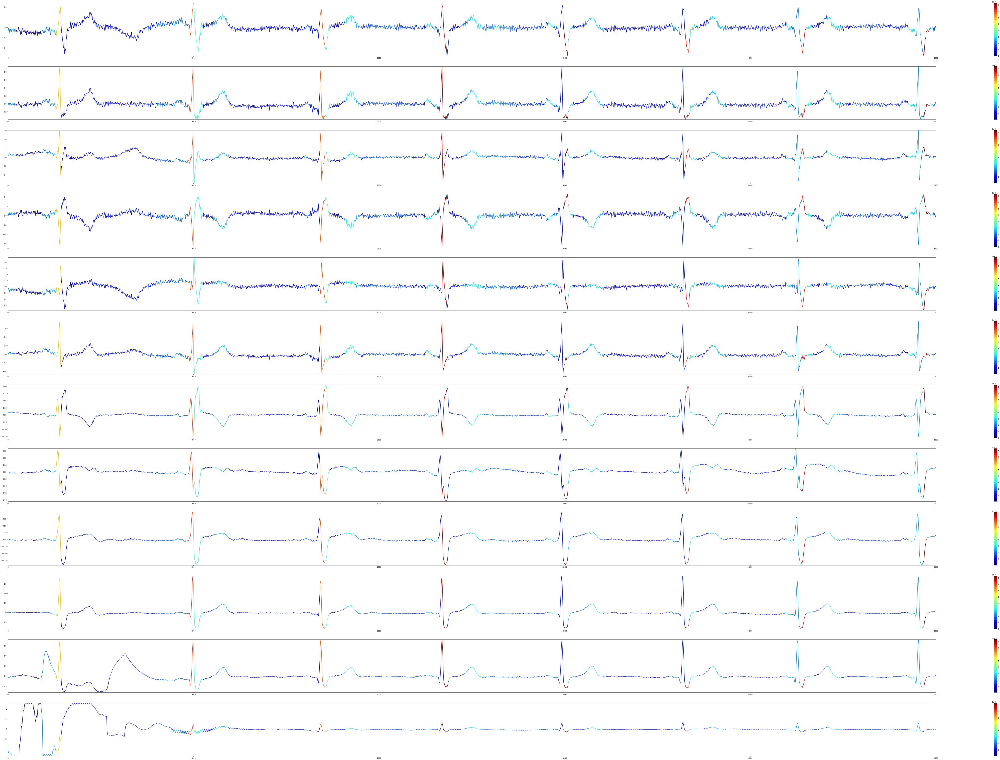

Original class: tensor([4])
Predicted class: 4


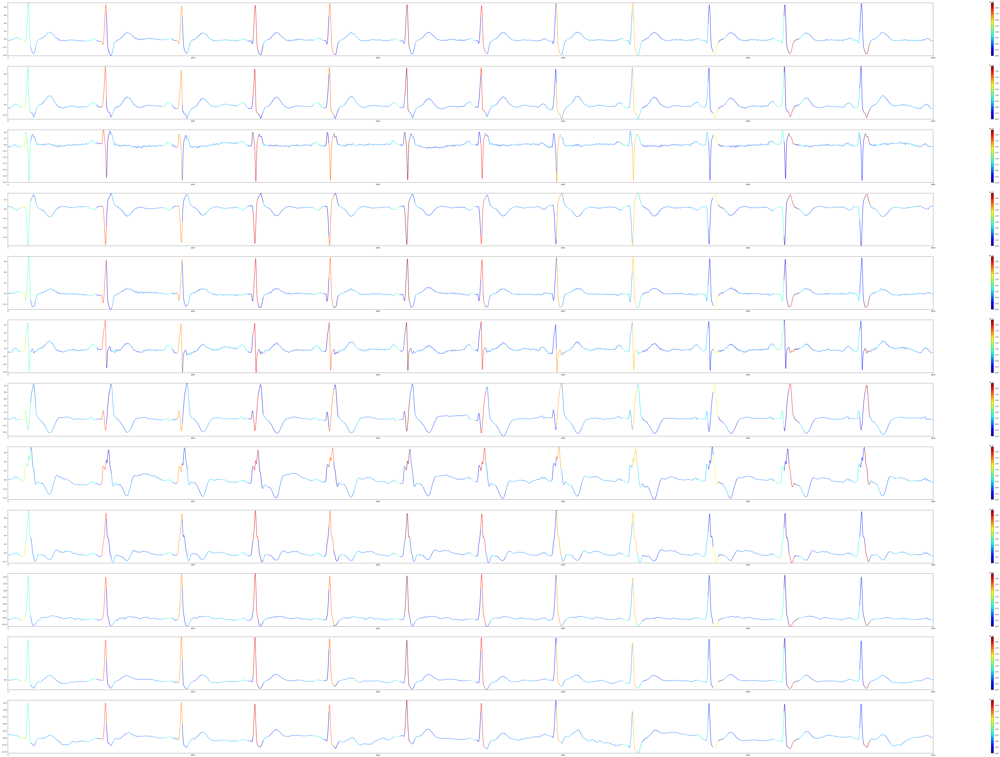

Original class: tensor([4])
Predicted class: 1


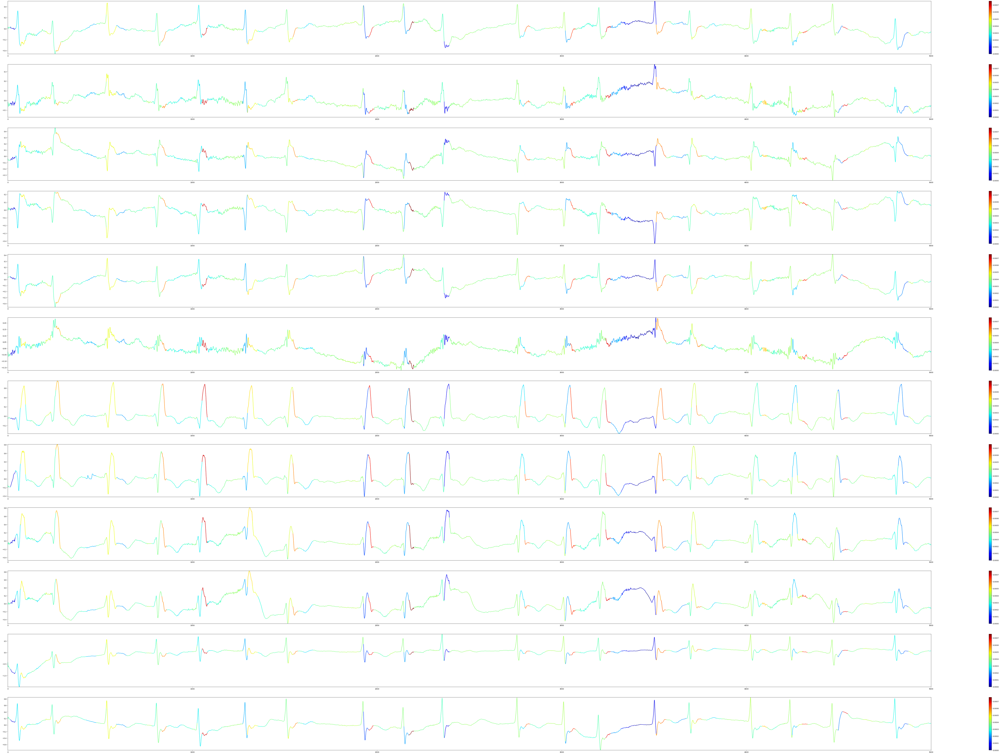

Original class: tensor([4])
Predicted class: 4


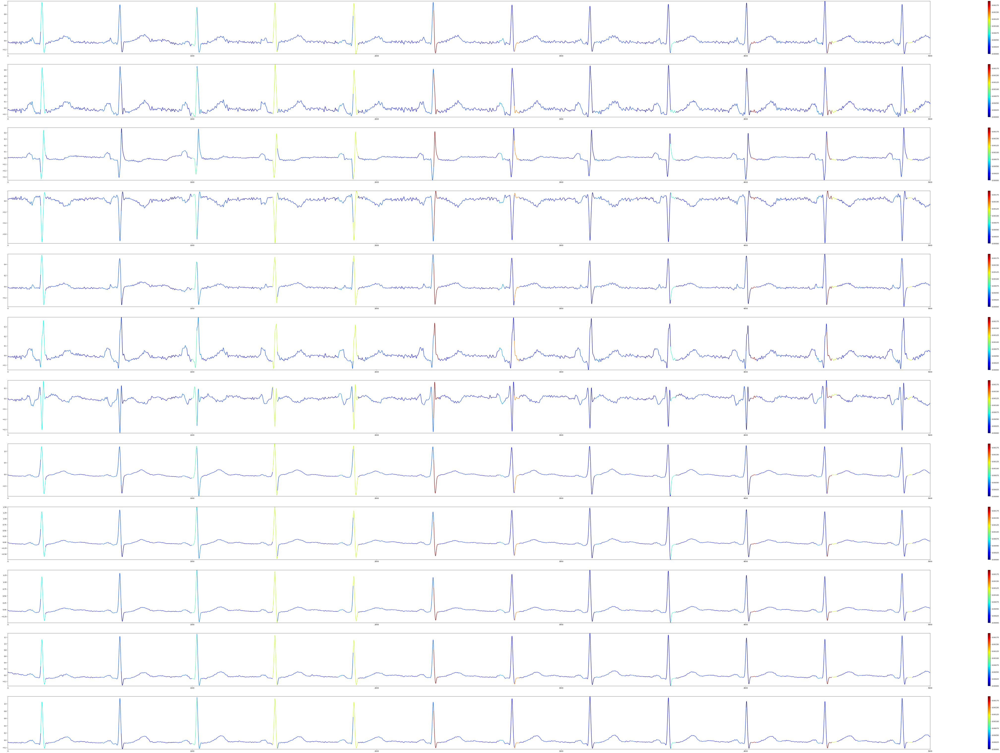

Original class: tensor([4])
Predicted class: 1


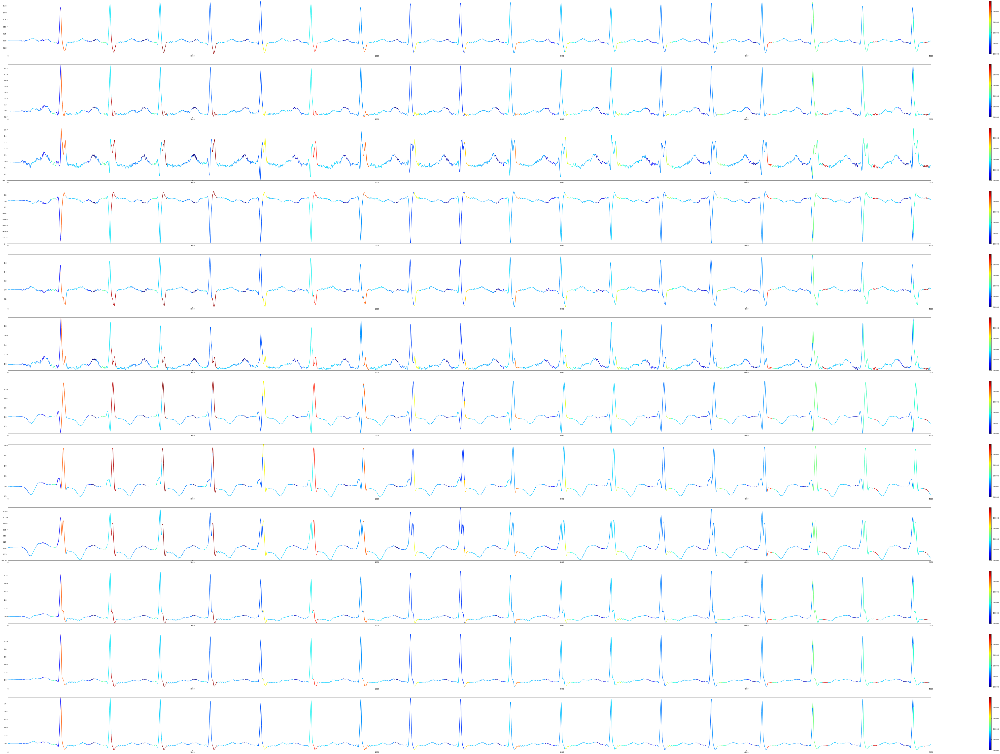

Original class: tensor([4])
Predicted class: 4


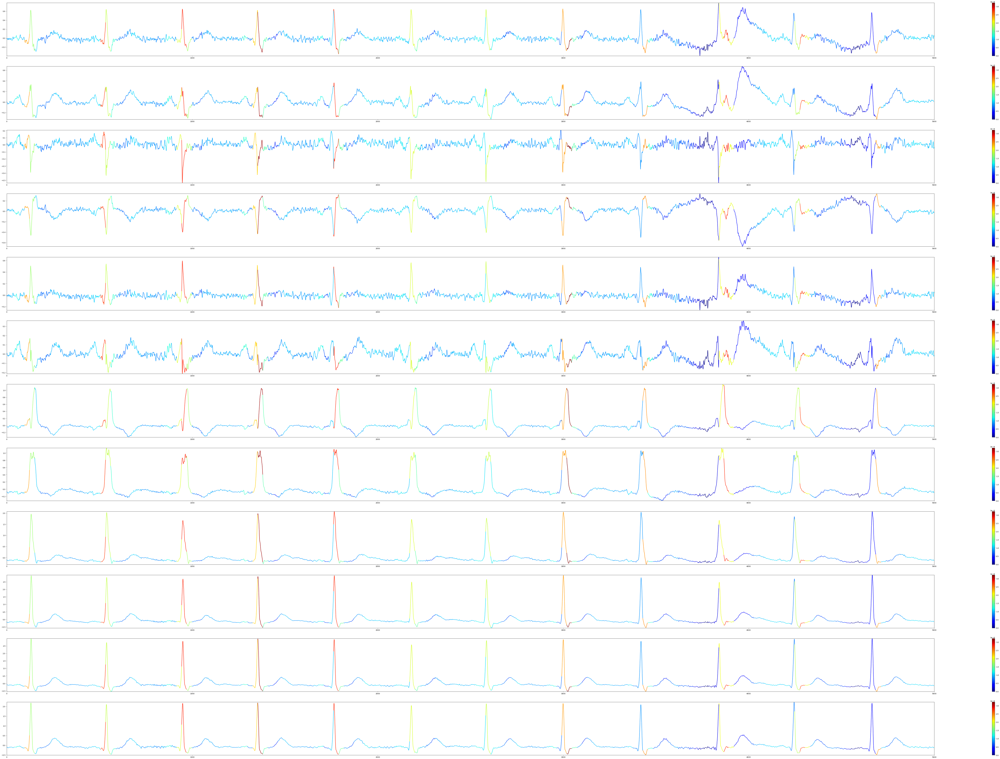

Original class: tensor([4])
Predicted class: 4


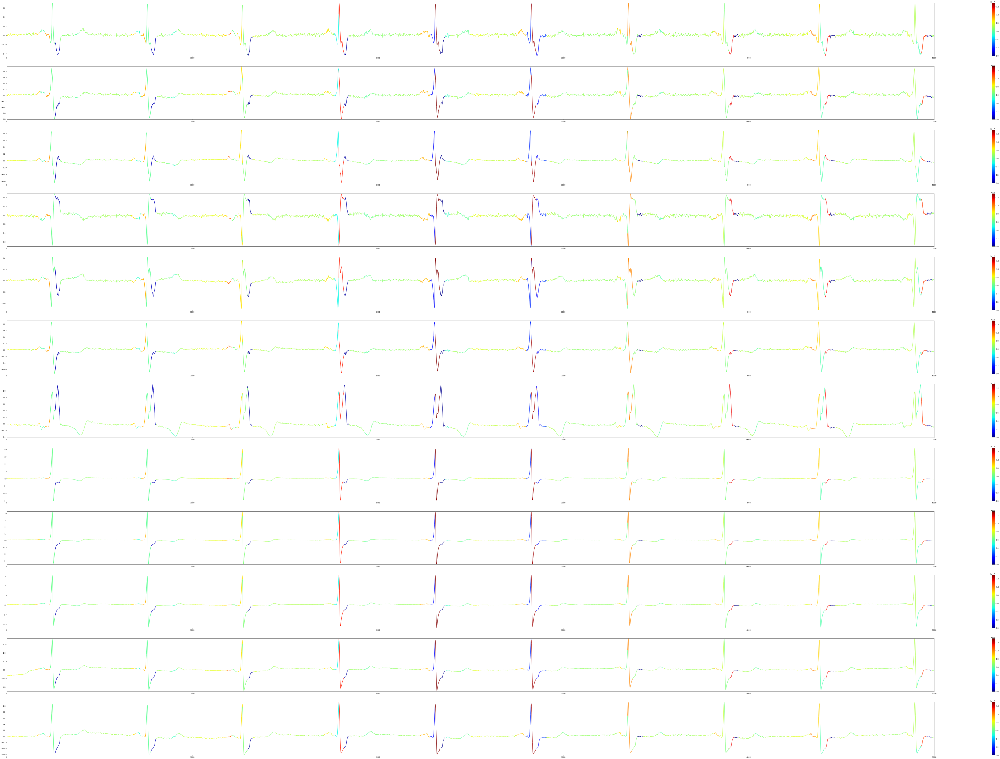

Original class: tensor([4])
Predicted class: 4


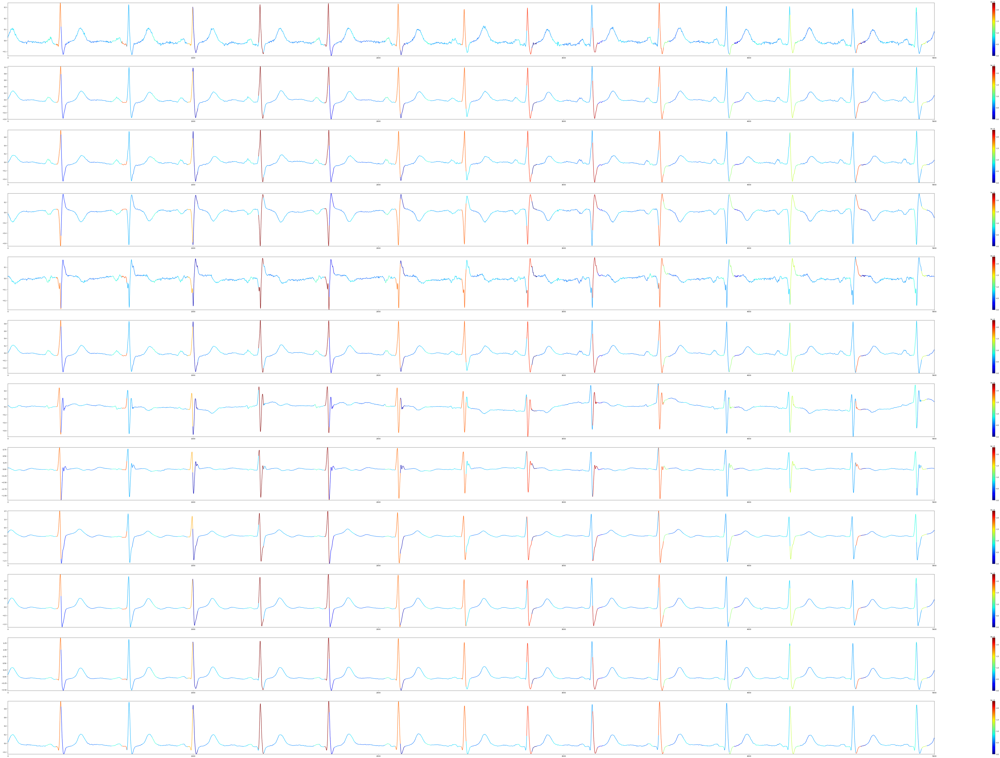

Original class: tensor([4])
Predicted class: 4


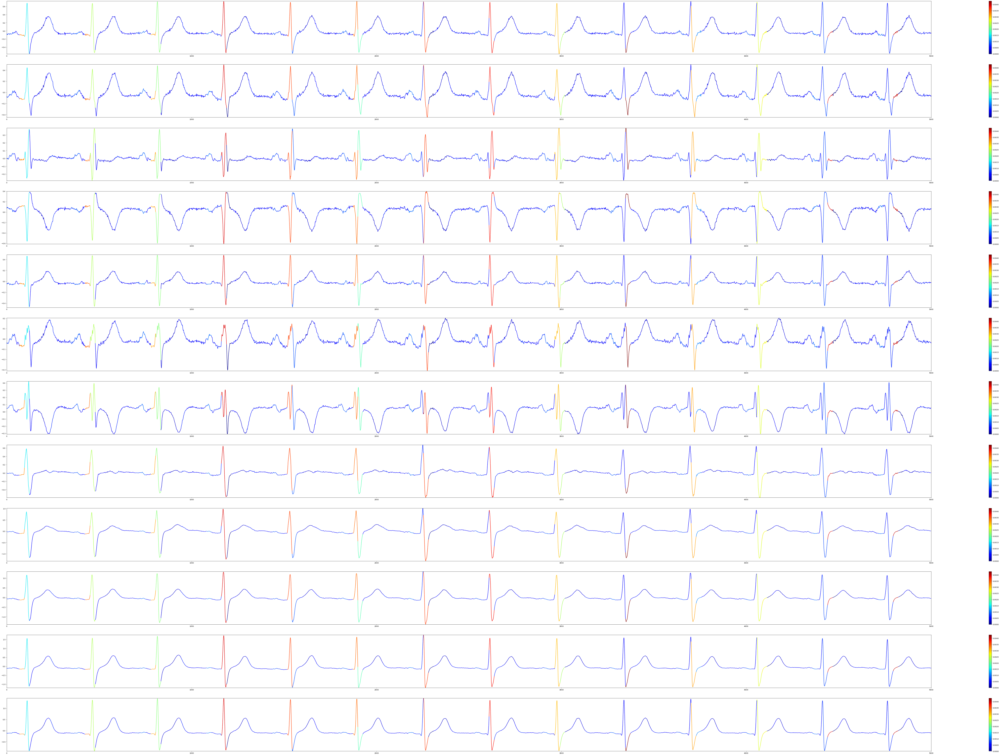

Original class: tensor([4])
Predicted class: 4


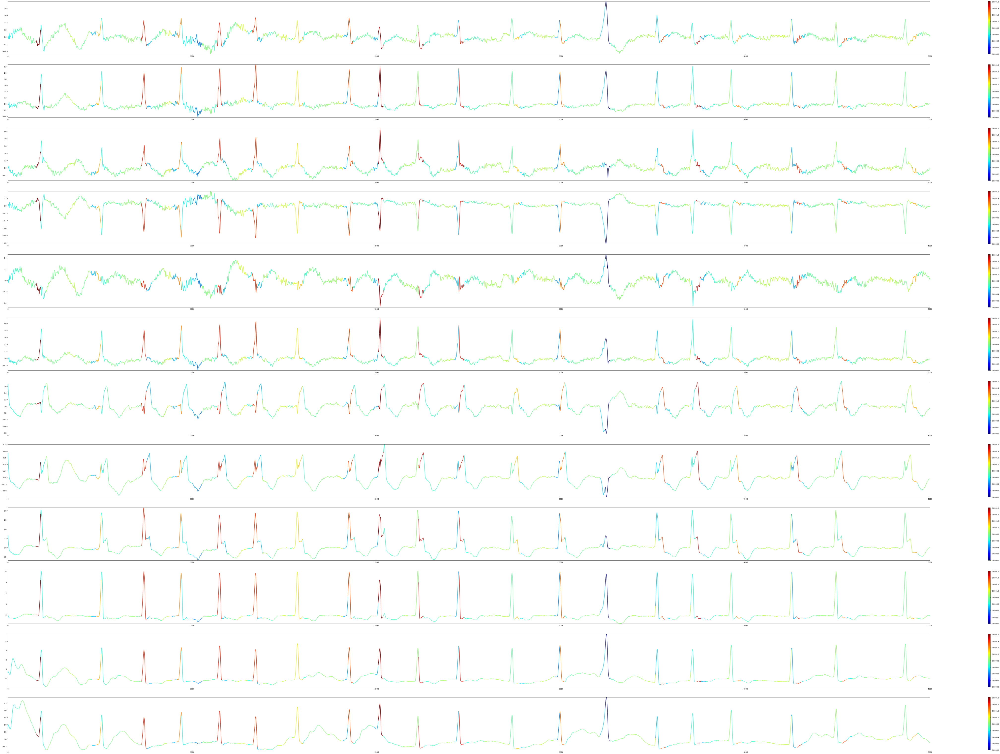

In [ ]:
model.eval()
data_manager = DataManager(
    train_dir=None,
    test_dir='data/test',
    labels_file='labels.csv',
    data_folder='samples',
    batch_size=1
)

iterator = iter(data_manager.get_test_loader(need_shuffle=False))
for i in range(0, records_to_show):
    sample = next(iterator)
    (x1, x2, y) = sample
    print(f'Original class: {y}')
    cam = extract_cam(model, sample)
    draw_cam(sample, cam)
